<a href="https://www.kaggle.com/code/poornimadevi/appliances-energy-prediction?scriptVersionId=139213472" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns
import datetime as dt
from datetime import datetime
from matplotlib import pyplot as plt
import plotly.express as px

import warnings 
warnings.simplefilter('ignore')
%matplotlib Inline

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/appliances-energy-prediction/KAG_energydata_complete.csv


#  **Attribute Information:**

date time year-month-day hour:minute:second \
Appliances, energy use in Wh \
lights, energy use of light fixtures in the house in Wh \
T1, Temperature in kitchen area, in Celsius\
RH_1, Humidity in kitchen area, in % \
T2, Temperature in living room area, in Celsius \
RH_2, Humidity in living room area, in % \
T3, Temperature in laundry room area \
RH_3, Humidity in laundry room area, in %\
T4, Temperature in office room, in Celsius\
RH_4, Humidity in office room, in %\
T5, Temperature in bathroom, in Celsius\
RH_5, Humidity in bathroom, in %\
T6, Temperature outside the building (north side), in Celsius\
RH_6, Humidity outside the building (north side), in %\
T7, Temperature in ironing room , in Celsius\
RH_7, Humidity in ironing room, in %\
T8, Temperature in teenager room 2, in Celsius\
RH_8, Humidity in teenager room 2, in %\
T9, Temperature in parents room, in Celsius\
RH_9, Humidity in parents room, in %\
To, Temperature outside (from Chievres weather station), in Celsius\
Pressure (from Chievres weather station), in mm Hg\
RH_out, Humidity outside (from Chievres weather station), in %\
Wind speed (from Chievres weather station), in m/s\
Visibility (from Chievres weather station), in km\
Tdewpoint (from Chievres weather station), Â°C\
rv1, Random variable 1, nondimensional\
rv2, Random variable 2, nondimensional

# Some questions I am trying to answer: 
* How much energy is consumed in indoor and outdoor appliances?
* what is the coerration of humidity and temperature in indoor and outdoor environment?
* Does the environment of sensor affects the way enegry is consumed by appliances?
* Identify the appliances with low efficiency in home (which room)
* relationship between appliances and light
* How weather is coerrated with the energy consumption in homes and why this study is important? 

# Introduction:

The data set is at 10 min for about 4.5 months. The house temperature and humidity conditions were monitored with a ZigBee wireless sensor network. Each wireless node transmitted the temperature and humidity conditions around 3.3 min. Then, the wireless data was averaged for 10 minutes periods. The energy data was logged every 10 minutes with m-bus energy meters. Weather from the nearest airport weather station (Chievres Airport, Belgium) was downloaded from a public data set from Reliable Prognosis (rp5.ru), and merged together with the experimental data sets using the date and time column. Two random variables have been included in the data set for testing the regression models and to filter out non predictive attributes (parameters).

# Data exploration:

In [2]:
#reading the dataset

data = pd.read_csv("../input/appliances-energy-prediction/KAG_energydata_complete.csv")

In [3]:
#looking at the dataset
data.head(3)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,17.000000,45.50,6.366667,733.7,92.0,6.333333,55.333333,5.1,28.642668,28.642668


In [4]:
data.tail(5)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
19730,2016-05-27 17:20:00,100,0,25.566667,46.560000,25.890000,42.025714,27.200000,41.163333,24.7,...,23.2,46.7900,22.733333,755.2,55.666667,3.333333,23.666667,13.333333,43.096812,43.096812
19731,2016-05-27 17:30:00,90,0,25.500000,46.500000,25.754000,42.080000,27.133333,41.223333,24.7,...,23.2,46.7900,22.600000,755.2,56.000000,3.500000,24.500000,13.300000,49.282940,49.282940
19732,2016-05-27 17:40:00,270,10,25.500000,46.596667,25.628571,42.768571,27.050000,41.690000,24.7,...,23.2,46.7900,22.466667,755.2,56.333333,3.666667,25.333333,13.266667,29.199117,29.199117
19733,2016-05-27 17:50:00,420,10,25.500000,46.990000,25.414000,43.036000,26.890000,41.290000,24.7,...,23.2,46.8175,22.333333,755.2,56.666667,3.833333,26.166667,13.233333,6.322784,6.322784
19734,2016-05-27 18:00:00,430,10,25.500000,46.600000,25.264286,42.971429,26.823333,41.156667,24.7,...,23.2,46.8450,22.200000,755.2,57.000000,4.000000,27.000000,13.200000,34.118851,34.118851


In [5]:
#shape of the date
data.shape

(19735, 29)

In [6]:
data.describe()

,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
count,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,...,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000,19735.000000
mean,97.694958,3.801875,21.686571,40.259739,20.341219,40.420420,22.267611,39.242500,20.855335,39.026904,...,19.485828,41.552401,7.411665,755.522602,79.750418,4.039752,38.330834,3.760707,24.988033,24.988033
std,102.524891,7.935988,1.606066,3.979299,2.192974,4.069813,2.006111,3.254576,2.042884,4.341321,...,2.014712,4.151497,5.317409,7.399441,14.901088,2.451221,11.794719,4.194648,14.496634,14.496634
min,10.000000,0.000000,16.790000,27.023333,16.100000,20.463333,17.200000,28.766667,15.100000,27.660000,...,14.890000,29.166667,-5.000000,729.300000,24.000000,0.000000,1.000000,-6.600000,0.005322,0.005322
25%,50.000000,0.000000,20.760000,37.333333,18.790000,37.900000,20.790000,36.900000,19.530000,35.530000,...,18.000000,38.500000,3.666667,750.933333,70.333333,2.000000,29.000000,0.900000,12.497889,12.497889
50%,60.000000,0.000000,21.600000,39.656667,20.000000,40.500000,22.100000,38.530000,20.666667,38.400000,...,19.390000,40.900000,6.916667,756.100000,83.666667,3.666667,40.000000,3.433333,24.897653,24.897653
75%,100.000000,0.000000,22.600000,43.066667,21.500000,43.260000,23.290000,41.760000,22.100000,42.156667,...,20.600000,44.338095,10.408333,760.933333,91.666667,5.500000,40.000000,6.566667,37.583769,37.583769
max,1080.000000,70.000000,26.260000,63.360000,29.856667,56.026667,29.236000,50.163333,26.200000,51.090000,...,24.500000,53.326667,26.100000,772.300000,100.000000,14.000000,66.000000,15.500000,49.996530,49.996530


In [7]:
#looking at null values
data.isnull().sum()

date           0
Appliances     0
lights         0
T1             0
RH_1           0
T2             0
RH_2           0
T3             0
RH_3           0
T4             0
RH_4           0
T5             0
RH_5           0
T6             0
RH_6           0
T7             0
RH_7           0
T8             0
RH_8           0
T9             0
RH_9           0
T_out          0
Press_mm_hg    0
RH_out         0
Windspeed      0
Visibility     0
Tdewpoint      0
rv1            0
rv2            0
dtype: int64

In [8]:
#checking datatype
data.dtypes

date            object
Appliances       int64
lights           int64
T1             float64
RH_1           float64
T2             float64
RH_2           float64
T3             float64
RH_3           float64
T4             float64
RH_4           float64
T5             float64
RH_5           float64
T6             float64
RH_6           float64
T7             float64
RH_7           float64
T8             float64
RH_8           float64
T9             float64
RH_9           float64
T_out          float64
Press_mm_hg    float64
RH_out         float64
Windspeed      float64
Visibility     float64
Tdewpoint      float64
rv1            float64
rv2            float64
dtype: object

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19735 entries, 0 to 19734
Data columns (total 29 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   date         19735 non-null  object 
 1   Appliances   19735 non-null  int64  
 2   lights       19735 non-null  int64  
 3   T1           19735 non-null  float64
 4   RH_1         19735 non-null  float64
 5   T2           19735 non-null  float64
 6   RH_2         19735 non-null  float64
 7   T3           19735 non-null  float64
 8   RH_3         19735 non-null  float64
 9   T4           19735 non-null  float64
 10  RH_4         19735 non-null  float64
 11  T5           19735 non-null  float64
 12  RH_5         19735 non-null  float64
 13  T6           19735 non-null  float64
 14  RH_6         19735 non-null  float64
 15  T7           19735 non-null  float64
 16  RH_7         19735 non-null  float64
 17  T8           19735 non-null  float64
 18  RH_8         19735 non-null  float64
 19  T9  

In [10]:
#converting date into datetime
data['date'] = data['date'].astype('datetime64[ns]')

In [11]:
data.head(2)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.7900,19.79,44.73,19.0,...,17.033333,45.53,6.600000,733.5,92.0,7.000000,63.000000,5.3,13.275433,13.275433
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.7225,19.79,44.79,19.0,...,17.066667,45.56,6.483333,733.6,92.0,6.666667,59.166667,5.2,18.606195,18.606195


In [12]:
data['Date'] = pd.to_datetime(data['date']).dt.date
data['Time'] = pd.to_datetime(data['date']).dt.time
data['hour'] = data['date'].dt.hour
data['month'] = data['date'].dt.month
data.tail(2)
#data['Dates'] = data['date'].values

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
19733,2016-05-27 17:50:00,420,10,25.5,46.99,25.414000,43.036000,26.890000,41.290000,24.7,...,56.666667,3.833333,26.166667,13.233333,6.322784,6.322784,2016-05-27,17:50:00,17,5
19734,2016-05-27 18:00:00,430,10,25.5,46.60,25.264286,42.971429,26.823333,41.156667,24.7,...,57.000000,4.000000,27.000000,13.200000,34.118851,34.118851,2016-05-27,18:00:00,18,5


Skewness value greater than 1 or less than -1 indicates highly skewed distribution. A value between 0.5 and 1 or -o.5 and -1 is moderately skewed. A value between -0.5 and 0.5 indicates that the distribution is fairly symmetrical.
- Greater than 1 - RH_5
- -0.5 and 0.5 - RH_3,RH_1,RH_4,RH_9,RH_8,RH_7,RH_6,RH_2



# Data Visualization:
**- Correlation for all columns**

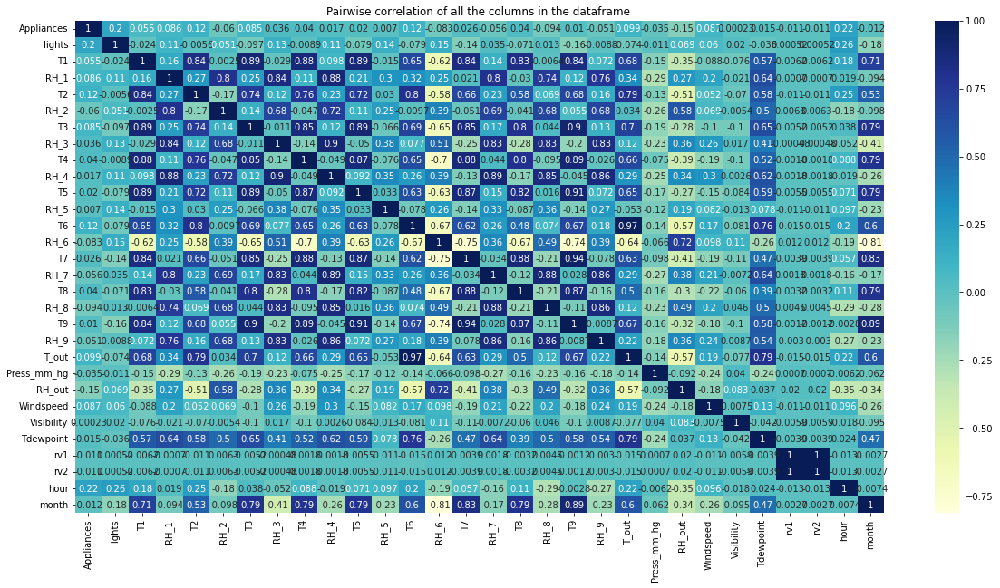

In [13]:
plt.figure(figsize = (20,10))
sns.heatmap(data= data.corr(), cmap="YlGnBu", annot= True)
plt.title("Pairwise correlation of all the columns in the dataframe ")
plt.show()

**Analyzing Humdity :**

In [14]:
#dropping columns to see humidity indoor and outdoor and how its correlated over time period 
new_data = data.loc[:, data.columns.drop(['date'])]
#'lights','T1','T2','T3','T4','T5','T6','T7','T8','T9','T_out','Press_mm_hg','Windspeed','Visibility','Tdewpoint','rv1','rv2'
print(new_data)



       Appliances  lights         T1       RH_1         T2       RH_2  \
0              60      30  19.890000  47.596667  19.200000  44.790000   
1              60      30  19.890000  46.693333  19.200000  44.722500   
2              50      30  19.890000  46.300000  19.200000  44.626667   
3              50      40  19.890000  46.066667  19.200000  44.590000   
4              60      40  19.890000  46.333333  19.200000  44.530000   
...           ...     ...        ...        ...        ...        ...   
19730         100       0  25.566667  46.560000  25.890000  42.025714   
19731          90       0  25.500000  46.500000  25.754000  42.080000   
19732         270      10  25.500000  46.596667  25.628571  42.768571   
19733         420      10  25.500000  46.990000  25.414000  43.036000   
19734         430      10  25.500000  46.600000  25.264286  42.971429   

              T3       RH_3         T4       RH_4  ...     RH_out  Windspeed  \
0      19.790000  44.730000  19.000000  45.

**-Correlation matrix for humdity indoor and outdoor**

In [15]:
corr_data=new_data.corr()

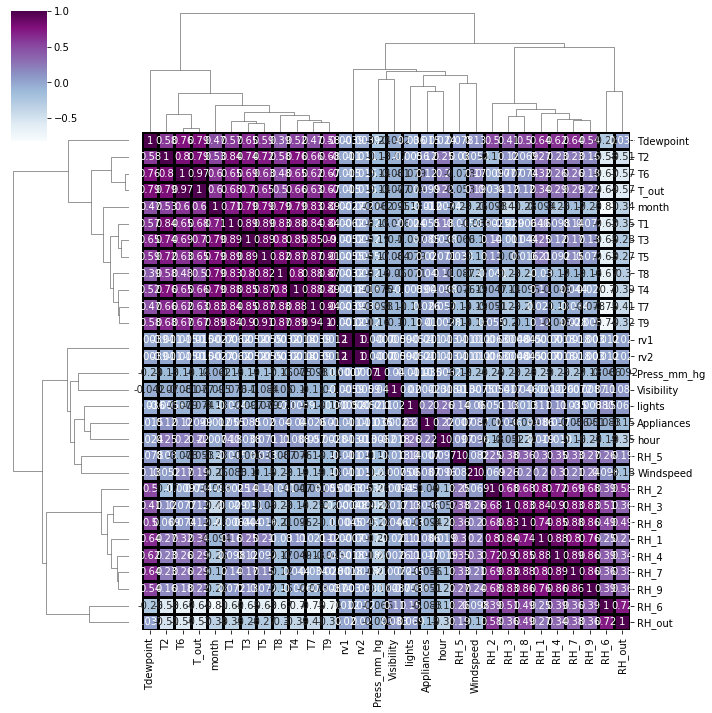

In [16]:
sns.clustermap(corr_data,  cmap="BuPu", annot=True, linecolor="black", linewidth=3)

In [17]:
new_data.corr().Appliances.sort_values(ascending=False) 

Appliances     1.000000
hour           0.216792
lights         0.197278
T2             0.120073
T6             0.117638
T_out          0.099155
Windspeed      0.087122
RH_1           0.086031
T3             0.085060
T1             0.055447
T4             0.040281
T8             0.039572
RH_3           0.036292
T7             0.025801
T5             0.019760
RH_4           0.016965
Tdewpoint      0.015353
T9             0.010010
RH_5           0.006955
Visibility     0.000230
rv1           -0.011145
rv2           -0.011145
month         -0.011606
Press_mm_hg   -0.034885
RH_9          -0.051462
RH_7          -0.055642
RH_2          -0.060465
RH_6          -0.083178
RH_8          -0.094039
RH_out        -0.152282
Name: Appliances, dtype: float64

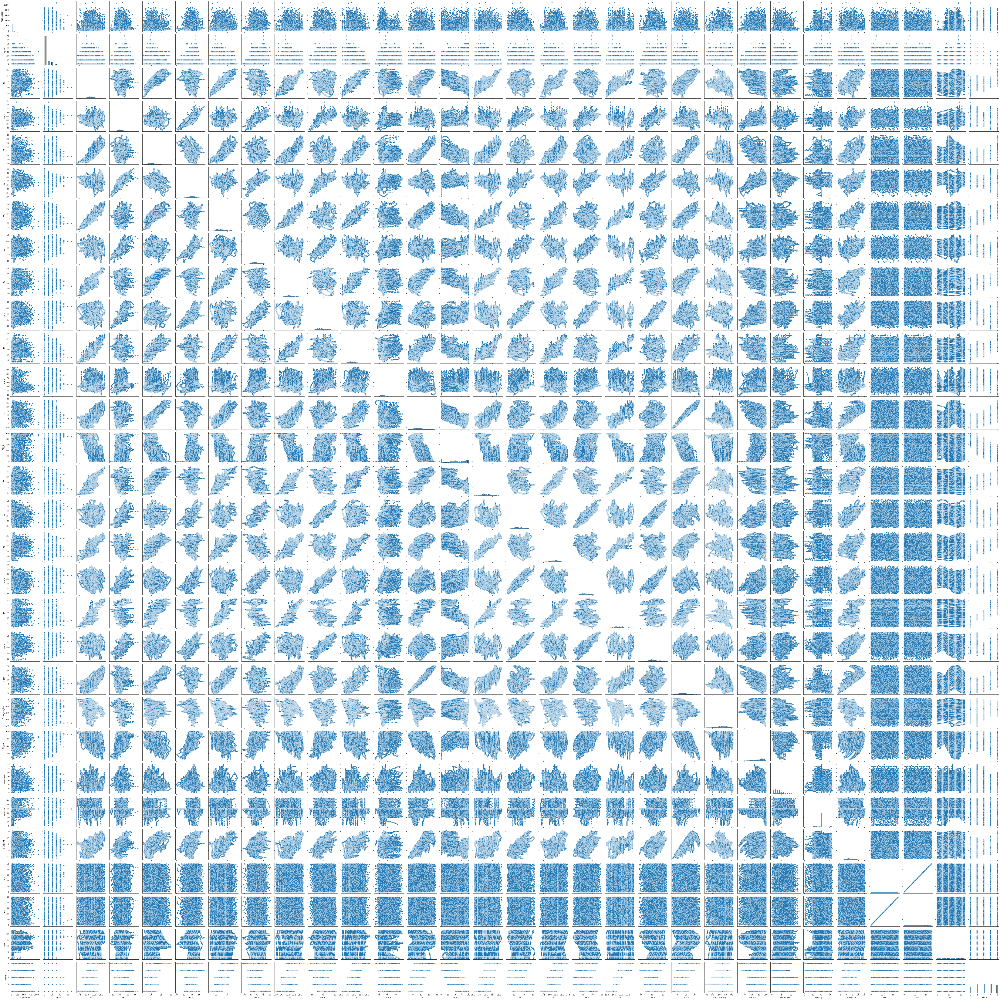

In [18]:
sns.pairplot(new_data, kind='scatter')
plt.show()

RH_1, Humidity in kitchen area, in %
RH_2, Humidity in living room area, in %
RH_3, Humidity in laundry room area, in %
RH_4, Humidity in office room, in %
RH_5, Humidity in bathroom, in %
RH_6, Humidity outside the building (north side), in %
RH_7, Humidity in ironing room, in %
RH_8, Humidity in teenager room 2, in %
RH_9, Humidity in parents room, in %
RH_out, Humidity outside (from Chievres weather station), in %

**Energy consumption of appliances:(time series) For First Month**

In [19]:
data.head(3)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.790000,19.79,44.730000,19.000000,...,92.0,7.000000,63.000000,5.3,13.275433,13.275433,2016-01-11,17:00:00,17,1
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.722500,19.79,44.790000,19.000000,...,92.0,6.666667,59.166667,5.2,18.606195,18.606195,2016-01-11,17:10:00,17,1
2,2016-01-11 17:20:00,50,30,19.89,46.300000,19.2,44.626667,19.79,44.933333,18.926667,...,92.0,6.333333,55.333333,5.1,28.642668,28.642668,2016-01-11,17:20:00,17,1


In [20]:
data['Date'] = pd.to_datetime(data['Date'])
energy = data.loc[(data['Date'] >= '2016-01-11')
                     & (data['Date'] < '2016-01-30')]

In [21]:
energy = data[[ 'Date','Appliances']]
energy.tail(2)

,Date,Appliances
19733,2016-05-27,420
19734,2016-05-27,430


In [22]:
energy.dtypes

Date          datetime64[ns]
Appliances             int64
dtype: object

In [23]:
energy['Date'] = pd.to_datetime(energy['Date'])
# Set the date as index 
energy = energy.set_index('Date')
energy.head()

,Appliances
Date,
2016-01-11,60
2016-01-11,60
2016-01-11,50
2016-01-11,50
2016-01-11,60


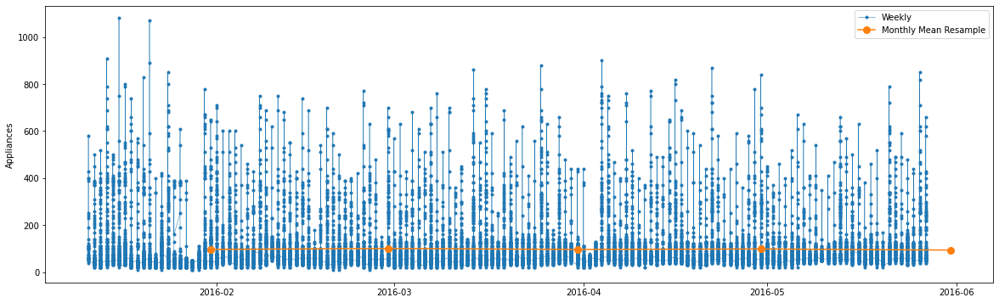

In [24]:
import warnings
y = energy['Appliances']
fig, ax = plt.subplots(figsize=(20, 6))
ax.plot(y,marker='.', linestyle='-', linewidth=0.5, label='Weekly')
ax.plot(y.resample('M').mean(),marker='o', markersize=8, linestyle='-', label='Monthly Mean Resample')
ax.set_ylabel('Appliances')
ax.legend();

**energy consumption for whole time period:**

In [25]:
energywhole = data[['Date','Appliances']]
energywhole.tail(2)

,Date,Appliances
19733,2016-05-27,420
19734,2016-05-27,430


In [26]:
energywhole['Date'] = pd.to_datetime(energywhole['Date'])
# Set the date as index 
energywhole = energywhole.set_index('Date')
energywhole.head(3)

,Appliances
Date,
2016-01-11,60
2016-01-11,60
2016-01-11,50


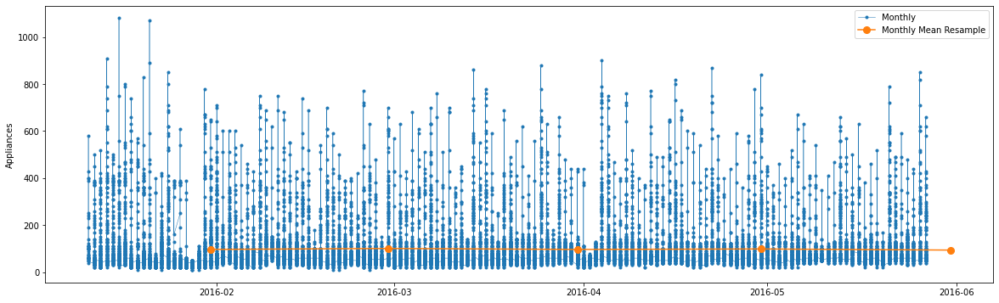

In [27]:
y = energywhole['Appliances']
fig, ax = plt.subplots(figsize=(20, 6))
ax.plot(y,marker='.', linestyle='-', linewidth=0.5, label='Monthly')
ax.plot(y.resample('M').mean(),marker='o', markersize=8, linestyle='-', label='Monthly Mean Resample')
ax.set_ylabel('Appliances')
ax.legend();

feb month has the highest energy consumption of appliances in home. This could mean people stayed more inside in the month feb. To find out if they stayed inside more because of weather conditions further analysis is made.

**Energy distribution of light (Wh) in appliances :**

In [28]:
energy1 = data[['Appliances','lights']]

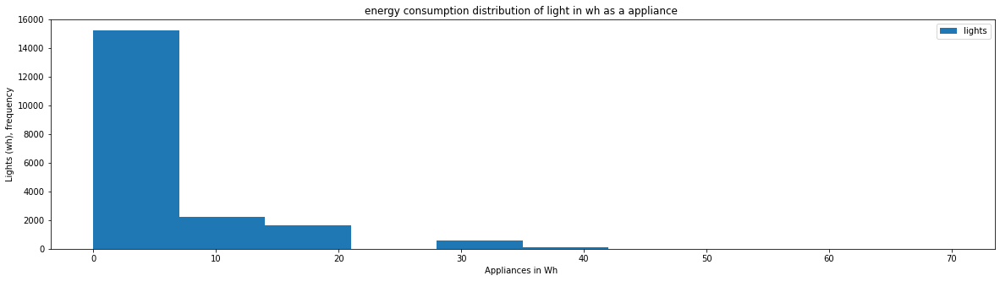

In [29]:
energy1.plot( x='Appliances', y='lights', figsize=(20, 5),kind='hist')
plt.xlabel("Appliances in Wh ")
plt.ylabel("Lights (wh), frequency")
plt.title("energy consumption distribution of light in wh as a appliance ")
plt.show()

The most used light is around 10 Watt-hour and the less used light bulb is 40 wh   

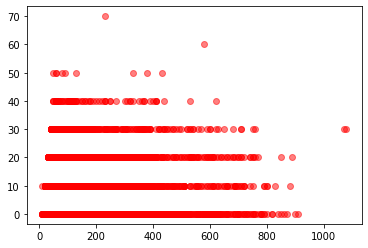

In [30]:
x= data["Appliances"]
y= data["lights"]
size=(20)
plt.scatter(x,y,color=["r"], alpha=0.5)

 **Appliances energy consumption with regards to weather outside:** 

In [31]:
data.head(2)

,date,Appliances,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,...,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2,Date,Time,hour,month
0,2016-01-11 17:00:00,60,30,19.89,47.596667,19.2,44.7900,19.79,44.73,19.0,...,92.0,7.000000,63.000000,5.3,13.275433,13.275433,2016-01-11,17:00:00,17,1
1,2016-01-11 17:10:00,60,30,19.89,46.693333,19.2,44.7225,19.79,44.79,19.0,...,92.0,6.666667,59.166667,5.2,18.606195,18.606195,2016-01-11,17:10:00,17,1


In [32]:
energy2 = data[['Appliances','Windspeed','Press_mm_hg']]

In [33]:
corr= energy2.corr()
corr

,Appliances,Windspeed,Press_mm_hg
Appliances,1.000000,0.087122,-0.034885
Windspeed,0.087122,1.000000,-0.235032
Press_mm_hg,-0.034885,-0.235032,1.000000


<AxesSubplot:>

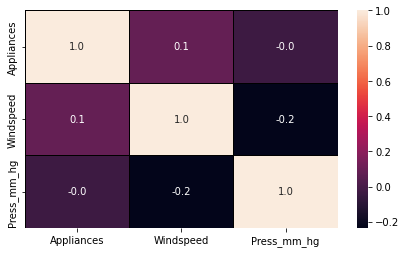

In [34]:
plt.figure(figsize=(7,4))
sns.heatmap(corr, annot=True, linecolor="black", linewidths=1, fmt='.1f')

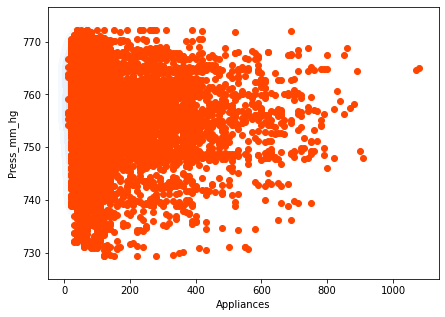

In [35]:
fig, ax = plt.subplots(1, figsize=(7,5))
sns.kdeplot(energy2.Appliances,energy2.Press_mm_hg,cmap='Blues',
           shade=True, shade_lowest=False)
plt.scatter(energy2.Appliances, energy2.Press_mm_hg,color='orangered')

In [36]:
energyweather = data[['Date','Press_mm_hg']]
energyweather.tail(2)

,Date,Press_mm_hg
19733,2016-05-27,755.2
19734,2016-05-27,755.2


In [37]:
energyweather['Date'] = pd.to_datetime(energyweather['Date'])
# Set the date as index 
energyweather = energyweather.set_index('Date')
energyweather.head(3)

,Press_mm_hg
Date,
2016-01-11,733.5
2016-01-11,733.6
2016-01-11,733.7


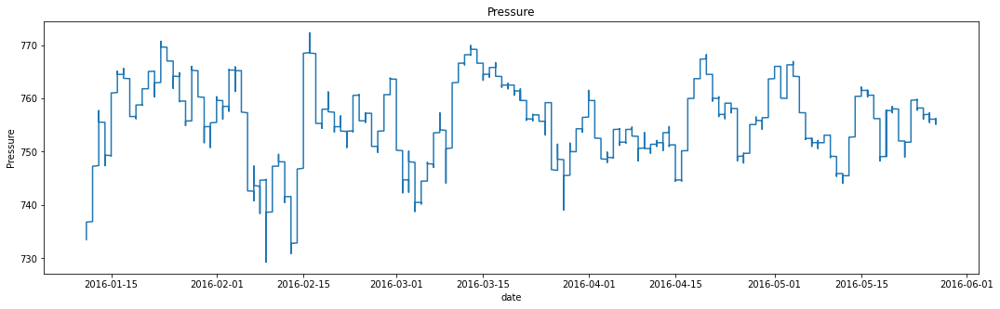

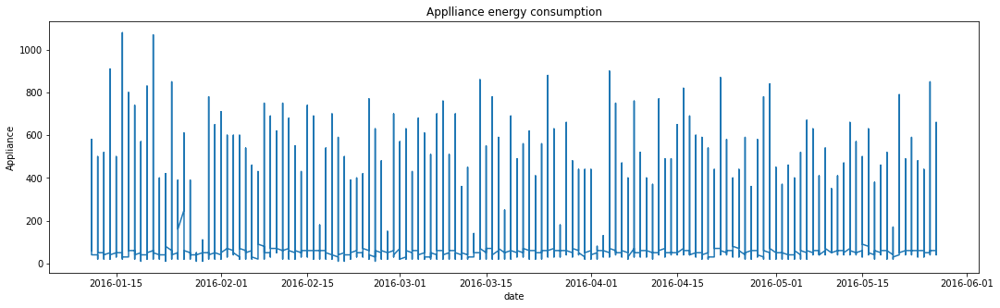

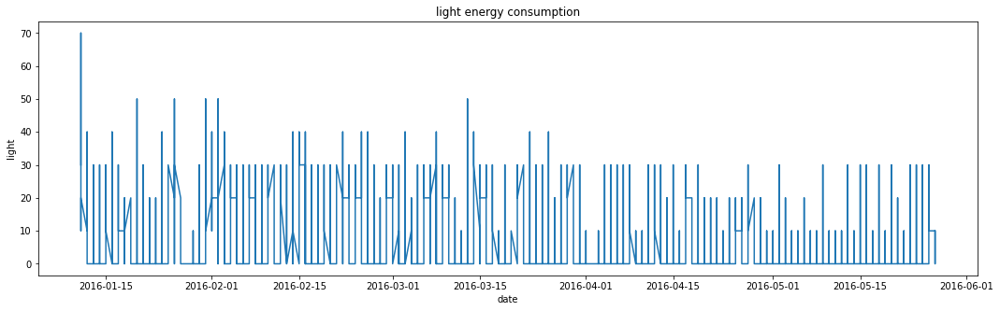

In [38]:
#ploting atmospheric pressure
date = data["Date"]
Pressure = data["Press_mm_hg"]
plt.figure(figsize=(18, 5))
plt.plot(date, Pressure, label="low")
plt.title("Pressure")
plt.xlabel("date")
plt.ylabel("Pressure")
plt.show()

#ploting appliance
date = data["Date"]
Appliance = data["Appliances"]
plt.figure(figsize=(18, 5))
plt.plot(date, Appliance, label="low")
plt.title("Applliance energy consumption")
plt.xlabel("date")
plt.ylabel("Appliance")
plt.show()

#ploting appliance
date = data["Date"]
light = data["lights"]
plt.figure(figsize=(18, 5))
plt.plot(date,light, label="low")
plt.title("light energy consumption")
plt.xlabel("date")
plt.ylabel("light")
plt.show()



when the atomospheric pressure is low it means it is raining, when the pressure is high it is warm weather. Jan month has the most energy consumption by appliances. So, it means peope used appliances more when its hot outside.  

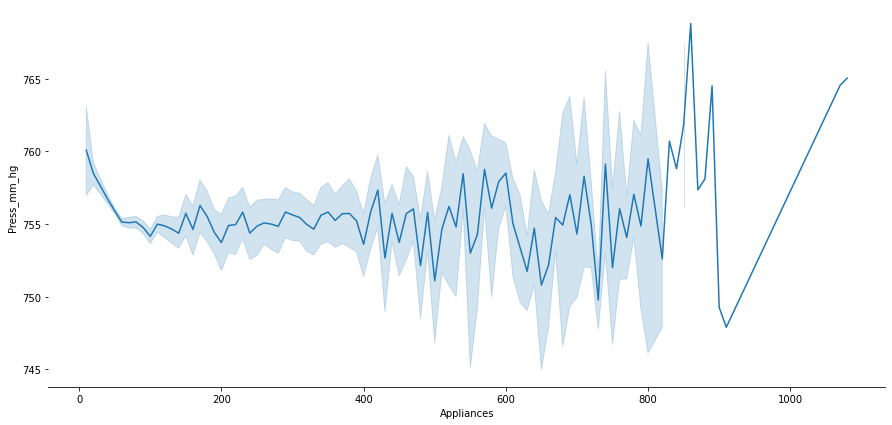

In [39]:
#plotting pressure and appliances
fig,ax = plt.subplots(figsize=(15,7))


chart=sns.lineplot(x='Appliances', y='Press_mm_hg', data= data)
sns.despine(left=True)


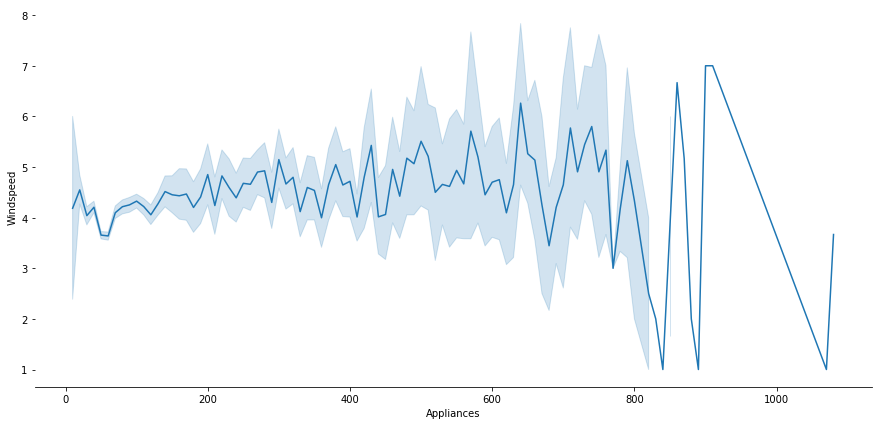

In [40]:
#plotting windspeed and appliances
fig,ax = plt.subplots(figsize=(15,7))


chart=sns.lineplot(x='Appliances', y='Windspeed', data= data)
sns.despine(left=True)


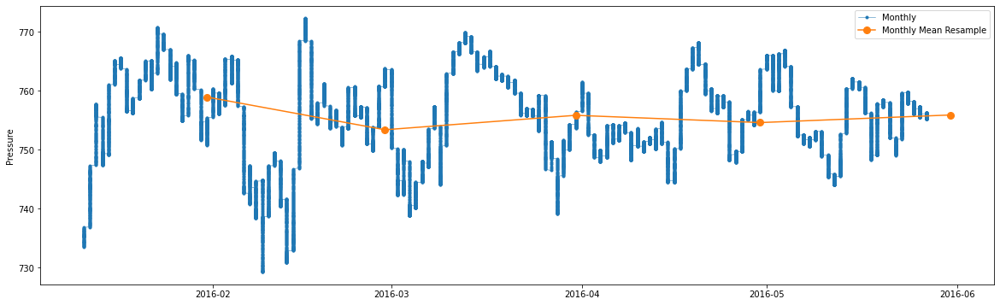

In [41]:
# plotting atomospheric pressure
y = energyweather['Press_mm_hg']
fig, ax = plt.subplots(figsize=(20, 6))
ax.plot(y,marker='.', linestyle='-', linewidth=0.5, label='Monthly')
ax.plot(y.resample('M').mean(),marker='o', markersize=8, linestyle='-', label='Monthly Mean Resample')
ax.set_ylabel('Pressure')
ax.legend();

**Predicting energy consumption of appliances :**


In [42]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets, linear_model, metrics  

In [43]:
  
# defining feature matrix(X) and response vector(y)
data['Date'] = pd.to_numeric(pd.to_datetime(data['Date']))
X = data.drop(['Appliances','Date','date','Time','hour','month'],axis=1)
y= data['Appliances']



In [44]:
X.head(1)

,lights,T1,RH_1,T2,RH_2,T3,RH_3,T4,RH_4,T5,...,T9,RH_9,T_out,Press_mm_hg,RH_out,Windspeed,Visibility,Tdewpoint,rv1,rv2
0,30,19.89,47.596667,19.2,44.79,19.79,44.73,19.0,45.566667,17.166667,...,17.033333,45.53,6.6,733.5,92.0,7.0,63.0,5.3,13.275433,13.275433


In [45]:
# splitting X and y into training and testing sets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4,
                                                    random_state=1)
  
# create linear regression object
reg = linear_model.LinearRegression()
  
# train the model using the training sets
model = reg.fit(X_train, y_train)
  

# regression coefficients
print('Coefficients: ', reg.coef_)
  
# variance score: 1 means perfect prediction
print('Variance score: {}'.format(reg.score(X_test, y_test)))
  


Coefficients:  [ 2.10848543e+00 -1.47650456e+00  1.47895171e+01 -1.62646701e+01
 -1.26848619e+01  2.60648784e+01  4.34009422e+00 -3.85214977e+00
 -1.09031711e+00  9.46238725e-01  1.53285461e-01  7.12809409e+00
  4.40264131e-01  2.44645979e+00 -1.44856211e+00  6.29371713e+00
 -4.39328609e+00 -1.57323807e+01 -1.11005992e+00 -1.21462083e+01
  1.04926481e-01 -1.62452282e+00  1.75699212e+00  1.47480779e-01
  7.25705357e+00 -5.72632008e-03 -5.72632008e-03]
Variance score: 0.16721252089597172


In [46]:
y_pred =  model.predict(X_test)

In [47]:
from sklearn import metrics 
print(metrics.mean_absolute_error(y_test,y_pred))

print(metrics.mean_squared_error(y_test,y_pred)) 

53.03985613342286
8638.805901029984


In [48]:
from sklearn.metrics import r2_score
r_squared = reg.score(X, y)

#view R-squared value
print(r_squared)

0.16418604755806576


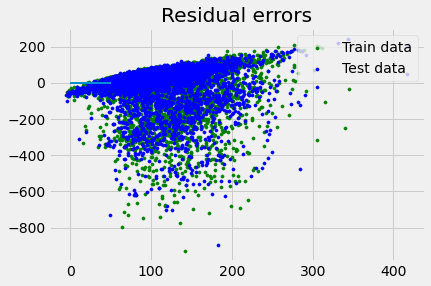

In [49]:
# plot for residual error
  
## setting plot style
plt.style.use('fivethirtyeight')
  
## plotting residual errors in training data
plt.scatter(reg.predict(X_train), reg.predict(X_train) - y_train,
            color = "green", s = 10, label = 'Train data')
  
## plotting residual errors in test data
plt.scatter(reg.predict(X_test), reg.predict(X_test) - y_test,
            color = "blue", s = 10, label = 'Test data')
  
## plotting line for zero residual error
plt.hlines(y = 0, xmin = 0, xmax = 50, linewidth = 2)
  
## plotting legend
plt.legend(loc = 'upper right')
  
## plot title
plt.title("Residual errors")
  
## method call for showing the plot
plt.show()

# **Random forest Regression** 

In [50]:
from sklearn.model_selection import train_test_split 
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor

In [51]:
# defining feature matrix(X) and response vector(y)
data['Date'] = pd.to_numeric(pd.to_datetime(data['Date']))
x = data.drop(['Appliances','Date','date','Time','hour','month'],axis=1)
y= data['Appliances']



In [52]:
# Splitting the dataset into training and testing set (80/20)
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 28)

In [53]:
# Initializing the Random Forest Regression model with 10 decision trees
model = RandomForestRegressor(n_estimators=100,
random_state=0,bootstrap=True)


In [54]:
# Fitting the Random Forest Regression model to the data
model.fit(x_train, y_train)

RandomForestRegressor(random_state=0)

In [55]:
# Predicting the target values of the test set
y_pred = model.predict(x_test)

# RMSE (Root Mean Square Error)
rmse = float(format(np.sqrt(mean_squared_error(y_test, y_pred)), '.3f'))
print("\nRMSE: ", rmse)


RMSE:  67.562


In [56]:
# evaluate the model
score = model.score(x_test, y_test)
score

0.5197929206229748

In [57]:
from sklearn.metrics import r2_score
r_squared = model.score(x, y)

#view R-squared value
print(r_squared)

0.858498720858001
